In [1]:
import os, sys
from pathlib import Path
print(os.getcwd())
print(os.getcwd())

parent_dir = Path.cwd().parent.resolve()
if str(parent_dir) not in sys.path:
    sys.path.insert(0, str(parent_dir))

%load_ext autoreload
%autoreload 2

/home/lsbicego/dit-editor
/home/lsbicego/dit-editor


In [2]:
os.getcwd()

'/home/lsbicego/dit-editor'

In [14]:
!pip install -e .

Obtaining file:///home/lsbicego/dit-editor
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
Requireme^C

[notice] A new release of pip is available: 24.3.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip
ERROR: Operation cancelled by user


In [3]:
import numpy as np
import torch
from PIL import Image


import gc
from accelerate.utils import release_memory

# from src.dit_edit.data.benchmark_data import gather_images
from src.dit_edit.data.bulk_load import load_benchmark_data
from src.dit_edit.core.inversion import place_image_in_bounding_box, get_inverted_input_noise, resize_bounding_box, compose_noise_masks



# from importlib import reload
# import cache_and_edit
# reload(cache_and_edit)
# from cache_and_edit import *
# import cache_and_edit.hooks
# reload(cache_and_edit.hooks)


os.environ['HF_HOME'] = 'scratch/lsbicego'
os.environ['TRANSFORMERS_CACHE'] = 'scratch/lsbicego'
os.environ['HF_DATASETS_CACHE'] = 'scratch/lsbicego'


# os.environ['HF_HOME'] = '/scratch/nevali'
# os.environ['TRANSFORMERS_CACHE'] = '/scratch/nevali'
# os.environ['HF_DATASETS_CACHE'] = '/scratch/nevali'

In [4]:
import matplotlib.pyplot as plt

def clear_all_gpu_memory():
    # Run garbage collection
    gc.collect()

    # Get number of available GPUs
    num_gpus = torch.cuda.device_count()
    print(f"Found {num_gpus} GPU(s).")

    # Iterate through each GPU
    for device_id in range(num_gpus):
        with torch.cuda.device(device_id):
            torch.cuda.empty_cache()
            gc.collect()
            torch.cuda.reset_peak_memory_stats()
            torch.cuda.reset_accumulated_memory_stats()
            release_memory()
            torch.cuda.empty_cache()
            gc.collect()
            torch.cuda.ipc_collect()
    print("GPU memory cleared across all available devices.")

def display_side_by_side(image1, image2, image3, titles=None):
    """
    Display three images side by side with optional titles
    
    Args:
        image1, image2, image3: PIL Images to display
        titles: List of titles for each image. If None, no titles are shown.
    """
    
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    # Display each image
    axes[0].imshow(image1)
    axes[1].imshow(image2)
    axes[2].imshow(image3)
    
    # Set titles if provided
    if titles is not None:
        for i, title in enumerate(titles):
            axes[i].set_title(title)
    
    # Remove axis ticks
    for ax in axes:
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout()
    plt.show()
    return None


clear_all_gpu_memory()

Found 2 GPU(s).
GPU memory cleared across all available devices.


In [5]:
from dit_edit.core.flux_pipeline import EditedFluxPipeline
from dit_edit.core.cached_pipeline import CachedPipeline

dtype = torch.float16
pipe = EditedFluxPipeline.from_pretrained("black-forest-labs/FLUX.1-dev", 
                                    device_map="balanced",
                                    torch_dtype=dtype)
pipe.set_progress_bar_config(disable=True)



Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [6]:
from dit_edit.core.cached_pipeline import CachedPipeline
# Load cached pipeline
cached_pipe = CachedPipeline(pipe)

## Gather Data

In [8]:
os_path = "data/"
all_images = load_benchmark_data(os_path)

Skipping data/Real-Real/0029 a professional photograph of a tomato and strawberries, ultra realistic: Not all images are present in data/Real-Real/0029 a professional photograph of a tomato and strawberries, ultra realistic


Missing images in data/Real-Real/0029 a professional photograph of a tomato and strawberries, ultra realistic: fg_mask


Skipping data/Real-Painting/0021 an oil painting of a tomato, Van Gogh Style: Not all images are present in data/Real-Painting/0021 an oil painting of a tomato, Van Gogh Style


Missing images in data/Real-Painting/0021 an oil painting of a tomato, Van Gogh Style: fg_mask


Missing 2 images in data/


In [11]:
all_images.keys()

dict_keys(['Real-Sketch', 'Real-Cartoon', '__pycache__', 'Real-Real', 'Real-Painting'])

Category: real


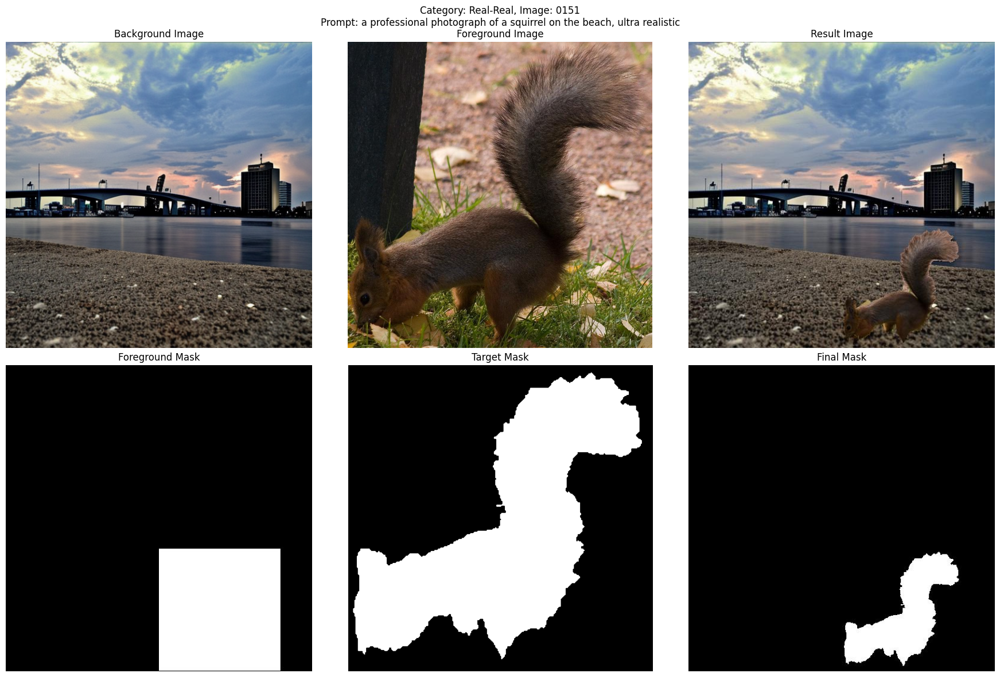

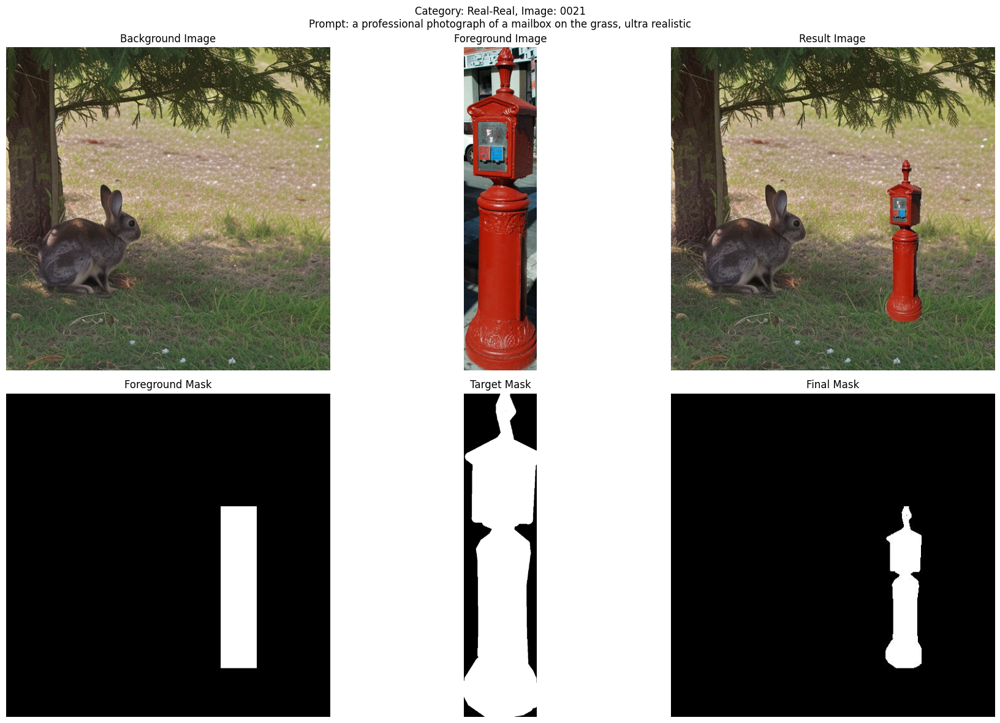



Category: sketch


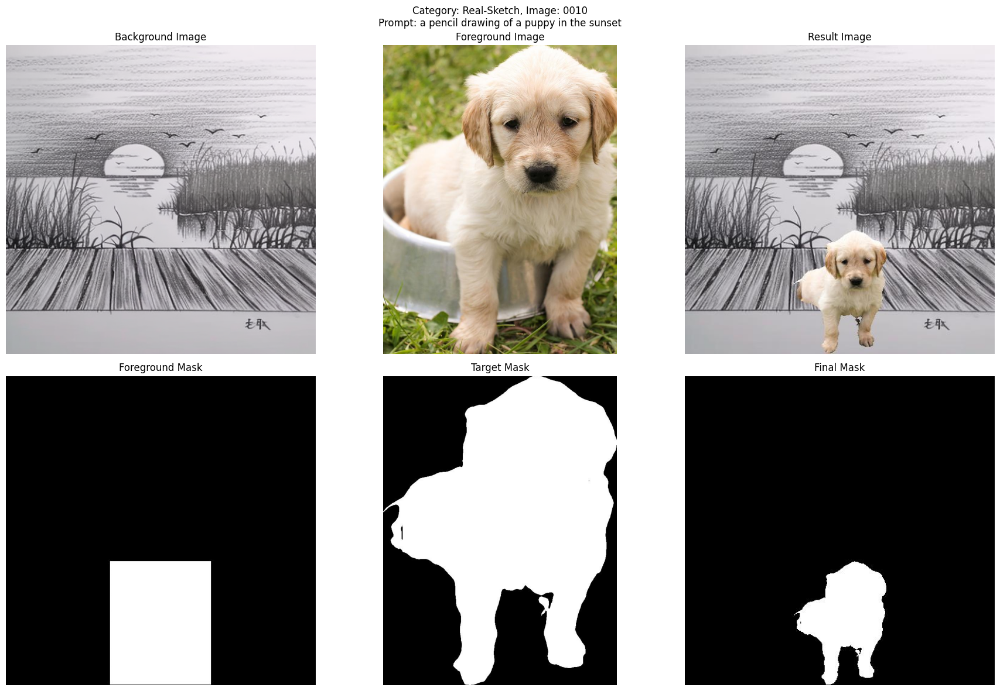

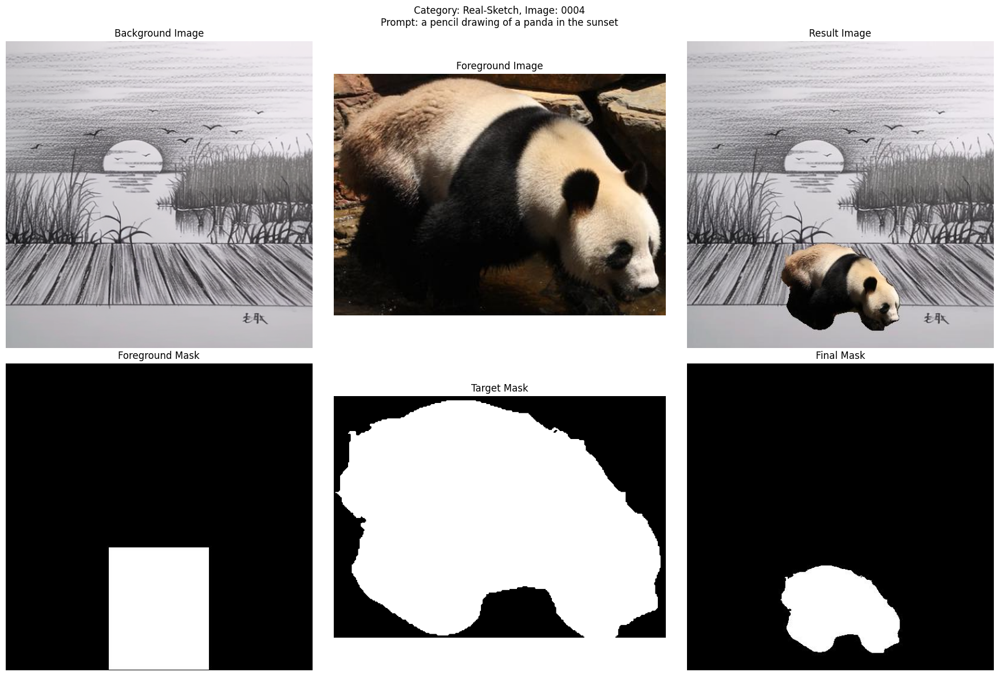



Category: painting


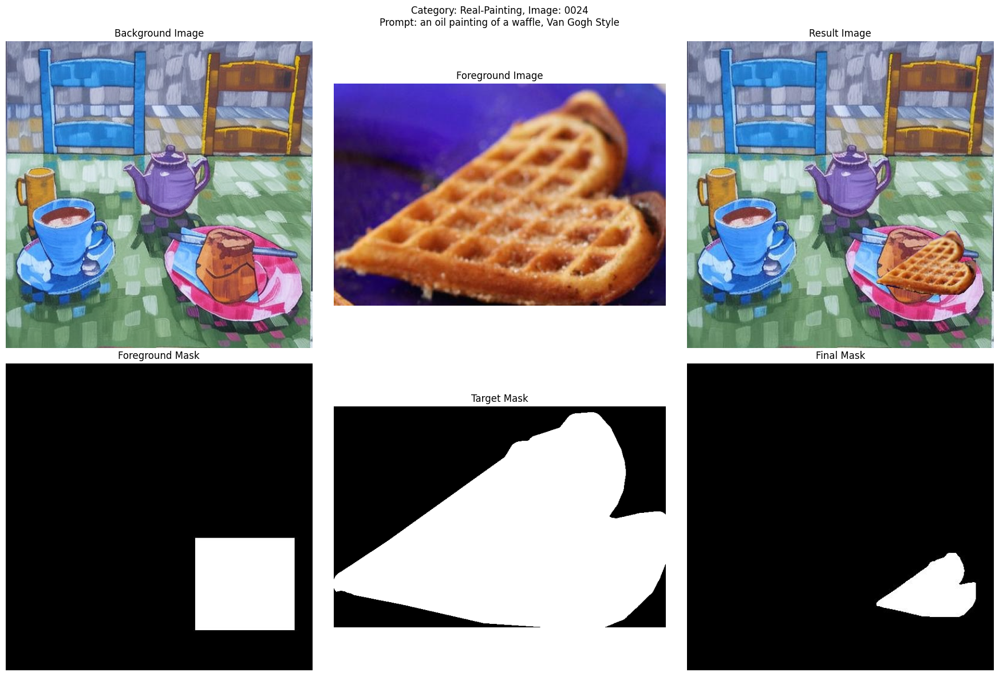

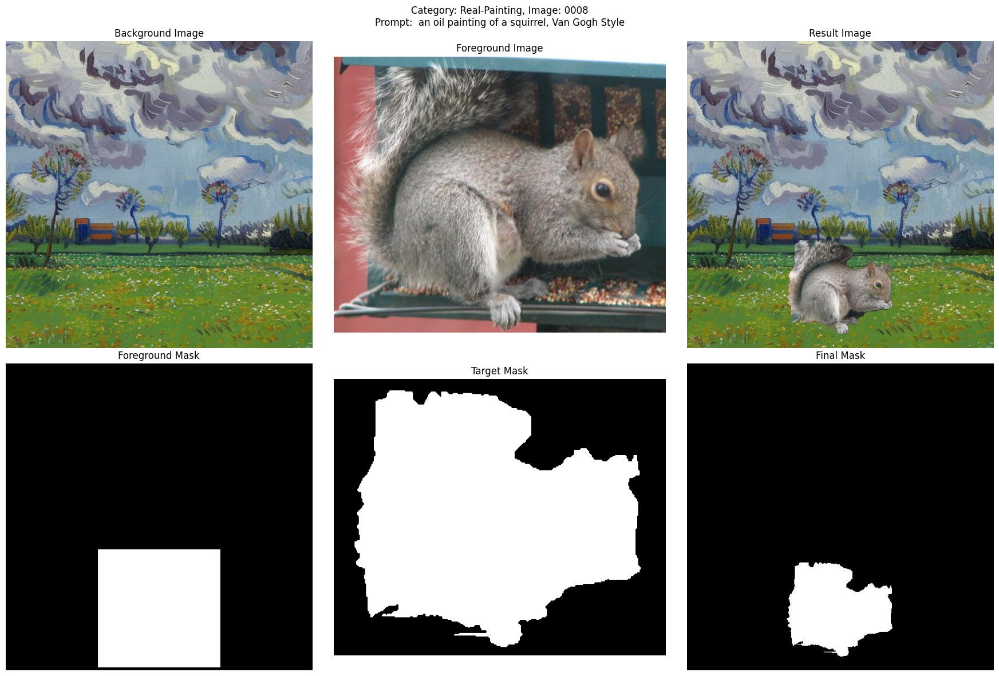



Category: cartoon


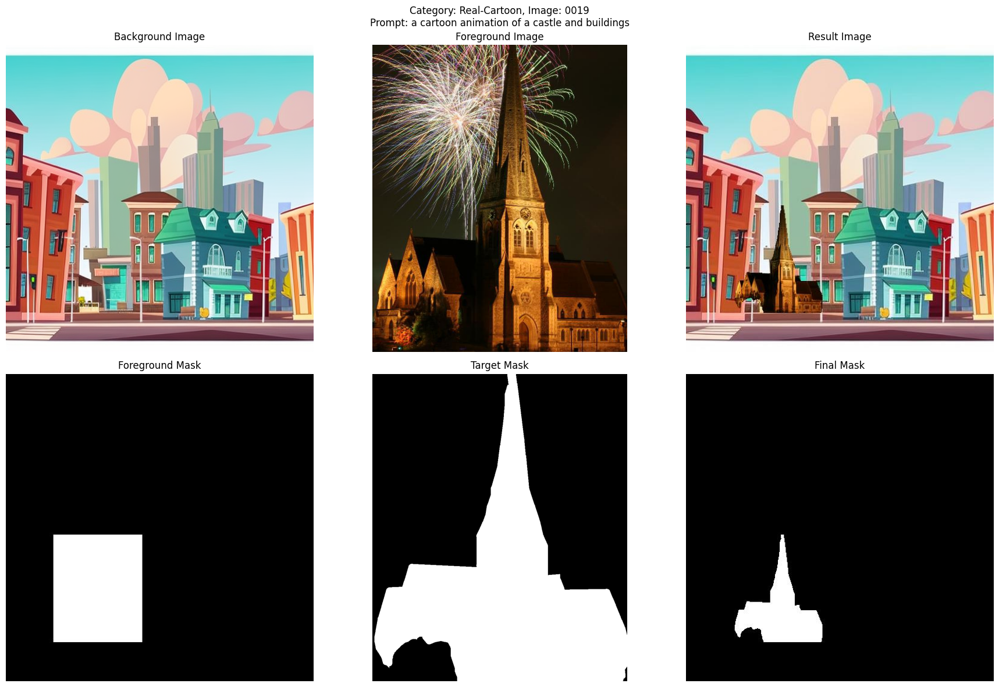

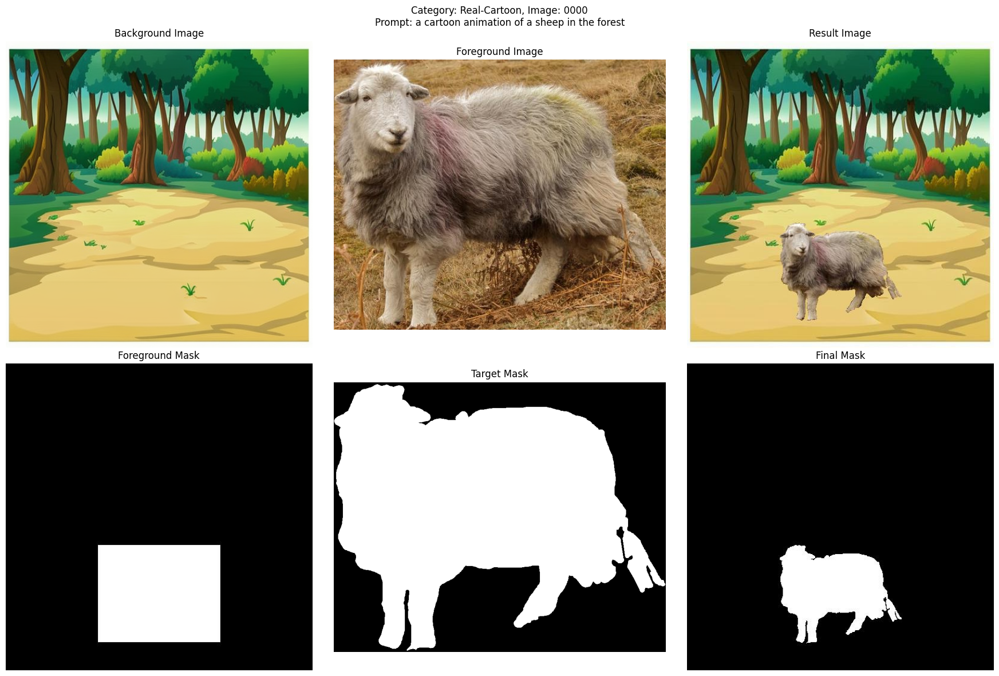

In [20]:
## TODO: select some images, and define corresponding editing prompts. 

# all_domains = [img.category for img in all_images]

# # find starting points of each domain
# domain_starts = {}
# for domain in all_domains:
#     if domain not in domain_starts:
#         domain_starts[domain] = all_domains.index(domain)
#     else:
#         domain_starts[domain] = min(domain_starts[domain], all_domains.index(domain))
# print(domain_starts)
from dit_edit.data.plotting import plot_sample

EXAMPLES_DICT = {"real": [all_images['Real-Real'][0], all_images['Real-Real'][100]],
                 "sketch": [all_images['Real-Sketch'][0], all_images['Real-Sketch'][20]],
                "painting": [all_images['Real-Painting'][0], all_images['Real-Painting'][2]],
                "cartoon": [all_images['Real-Cartoon'][0], all_images['Real-Cartoon'][10]]}


# show the selected images for each category
for category, examples in EXAMPLES_DICT.items():
    print(f"Category: {category}")
    for example in examples:
        plot_sample(example)
    print("\n")

In [ ]:
# EXAMPLES_DICT = {"real": [all_images['Real-Real'][0], all_images['Real-Real'][100]],
#                  "sketch": [all_images['Real-Sketch'][0], all_images['Real-Sketch'][20]],
#                 "painting": [all_images['Real-Painting'][0], all_images['Real-Painting'][2]],
#                 "cartoon": [all_images['Real-Cartoon'][0], all_images['Real-Cartoon'][10]]}

In [21]:
#print all promots
for category, examples in EXAMPLES_DICT.items():
    print(f"Category: {category}")
    for example in examples:
        print(f"Prompt: {example.prompt}")
    print("\n")

Category: real
Prompt: a professional photograph of a squirrel on the beach, ultra realistic
Prompt: a professional photograph of a mailbox on the grass, ultra realistic


Category: sketch
Prompt: a pencil drawing of a puppy in the sunset
Prompt: a pencil drawing of a panda in the sunset


Category: painting
Prompt: an oil painting of a waffle, Van Gogh Style
Prompt:  an oil painting of a squirrel, Van Gogh Style


Category: cartoon
Prompt: a cartoon animation of a castle and buildings
Prompt: a cartoon animation of a sheep in the forest




In [ ]:


PROMPTS_DICT = {
    ###
    EXAMPLES_DICT["real"][0]: ["", 
                               EXAMPLES_DICT["real"][0].prompt, 
                               "a professional photograph of a squirrel on the beach with a party hat, ultra realistic", 
                               "a professional photograph of a squirrel on the beach wearing sunglasses, ultra realistic"],
    EXAMPLES_DICT["real"][1]: ["", 
                               EXAMPLES_DICT["real"][1].prompt, 
                               "a professional photograph of a BLUE mailbox on the grass, ultra realistic", 
                                "a professional photograph of a red lamppost on the grass, ultra realistic"],

    ###
    EXAMPLES_DICT["sketch"][0]: ["", 
                               EXAMPLES_DICT["sketch"][0].prompt, 
                               "a pencil drawing of a puppy wearing a hat in the sunset", 
                               "a pencil drawing of a puppy wearing sunglasses in the sunset"],
    EXAMPLES_DICT["sketch"][1]: ["", 
                               EXAMPLES_DICT["sketch"][1].prompt, 
                               "a pencil drawing of a panda wearing a hat in the sunset", 
                                "a pencil drawing of a panda wearing sunglasses in the sunset"],

    ### 
    EXAMPLES_DICT["painting"][0]: ["", 
                               EXAMPLES_DICT["painting"][0].prompt, 
                               "an oil painting of a waffle with blueberries on top, Van Gogh Style", 
                               "an oil painting of a waffle with a big stack of butter on top, Van Gogh Style"],
    EXAMPLES_DICT["painting"][1]: ["", 
                               EXAMPLES_DICT["painting"][1].prompt, 
                               "an oil painting of a squirrel wearing a hat, Van Gogh Style", 
                                "an oil painting of a squirrel wearing sunglasses, Van Gogh Style"],


    ###
    EXAMPLES_DICT["cartoon"][0]: ["", 
                               EXAMPLES_DICT["cartoon"][0].prompt, 
                               "a cartoon animation of a pink princess castle and buildings", 
                               "a cartoon animation of a huge fortress and buildings"],
    EXAMPLES_DICT["cartoon"][1]: ["", 
                               EXAMPLES_DICT["cartoon"][1].prompt, 
                               "a cartoon animation of a black sheep in the forest", 
                                "a cartoon animation of a sheep in the forest, wearing a party hat"],

    }

In [ ]:
NUM_STEPS = 28

# alpha_random = 0.2 nicely working
alpha_random = 0.05


vital_layers = [f"transformer.transformer_blocks.{i}" for i in [0, 1, 17, 18]] + \
                [f"transformer.single_transformer_blocks.{i-19}" for i in [25, 28, 53, 54, 56]]

all_layers = [f"transformer.transformer_blocks.{i}" for i in range(19)] + \
                [f"transformer.single_transformer_blocks.{i-19}" for i in range(19, 57)]


CONFIG = {
    "num_steps": NUM_STEPS,
    "inject_q": True,
    "inject_k": True,
    "inject_v": True,
    "alpha_random": alpha_random,
    "layers": vital_layers,
    "inject_layers": all_layers
}

### Define some run function

In [25]:
from functools import partial
from dit_edit.core.processors.dit_edit_processor import DitEditProcessor

def run_editing_example(cached_pipe, example, prompt, CONFIG):
    NUM_STEPS = CONFIG["num_steps"]
    inject_q = CONFIG["inject_q"]
    inject_k = CONFIG["inject_k"]
    inject_v = CONFIG["inject_v"]
    alpha_random = CONFIG["alpha_random"]
    layers = CONFIG["layers"]
    inject_layers = CONFIG["inject_layers"]


    example_noise = compose_noise_masks(cached_pipe, 
                                example.fg_image, 
                                example.bg_image, 
                                example.target_mask, 
                                example.fg_mask, 
                                option="segmentation1", 
                                num_inversion_steps=50,
                                photoshop_fg_noise=True,)
    print('Running inject qkv')
    images = cached_pipe.run_inject_qkv(
        ["", "", prompt],
        num_inference_steps=NUM_STEPS,
        seed=42,
        guidance_scale=3,
        positions_to_inject=inject_layers,
        positions_to_inject_foreground=layers,
        empty_clip_embeddings=False,
        q_mask=example_noise["latent_masks"]["latent_segmentation_mask"],
        latents=torch.stack(
                            [
                            example_noise["noise"]["background_noise"],
                            example_noise["noise"]["foreground_noise"],
                            torch.where(
                                example_noise["latent_masks"]["latent_segmentation_mask"] > 0,
                                alpha_random * torch.randn_like(example_noise["noise"]["foreground_noise"]) + (1 - alpha_random) * example_noise["noise"]["foreground_noise"],
                                example_noise["noise"]["background_noise"],
                            ),
                            ]
                        ),
        processor_class=partial(
            DitEditProcessor,
            call_max_times=int(0.4 * NUM_STEPS),
            inject_q=inject_q,
            inject_k=inject_k,
            inject_v=inject_v,
            ),
        width=512,
        height=512,
        inverted_latents_list = list(zip(example_noise["noise"]["background_noise_list"], example_noise["noise"]["foreground_noise_list"])),
        tau_b=0.8,
        bg_consistency_mask=example_noise["latent_masks"]["latent_segmentation_mask"],
    )
    result_image = images[0][2]
    return result_image

Category: real
Example 1: Real-Real - a professional photograph of a squirrel on the beach, ultra realistic
Running with prompt: 
Running inject qkv
Running with prompt: a professional photograph of a squirrel on the beach, ultra realistic
Running inject qkv
Running with prompt: a professional photograph of a squirrel on the beach with a party hat, ultra realistic
Running inject qkv
Running with prompt: a professional photograph of a squirrel on the beach wearing sunglasses, ultra realistic
Running inject qkv


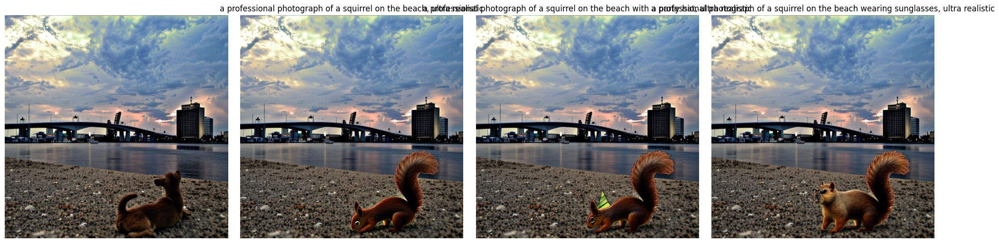

Example 2: Real-Real - a professional photograph of a mailbox on the grass, ultra realistic
Running with prompt: 
Running inject qkv
Running with prompt: a professional photograph of a mailbox on the grass, ultra realistic
Running inject qkv
Running with prompt: a professional photograph of a BLUE mailbox on the grass, ultra realistic
Running inject qkv
Running with prompt: a professional photograph of a red lamppost on the grass, ultra realistic
Running inject qkv


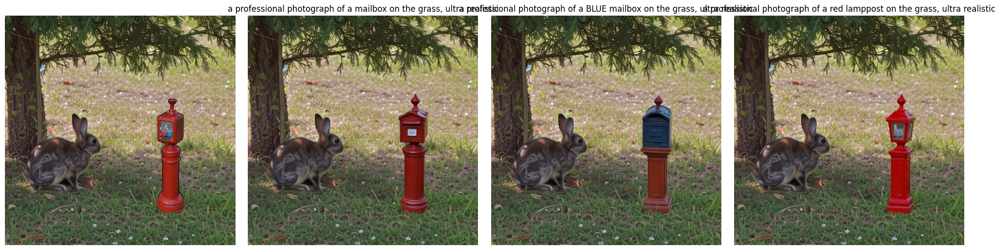

Category: sketch
Example 1: Real-Sketch - a pencil drawing of a puppy in the sunset
Running with prompt: 
Running inject qkv
Running with prompt: a pencil drawing of a puppy in the sunset
Running inject qkv
Running with prompt: a pencil drawing of a puppy wearing a hat in the sunset
Running inject qkv
Running with prompt: a pencil drawing of a puppy wearing sunglasses in the sunset
Running inject qkv


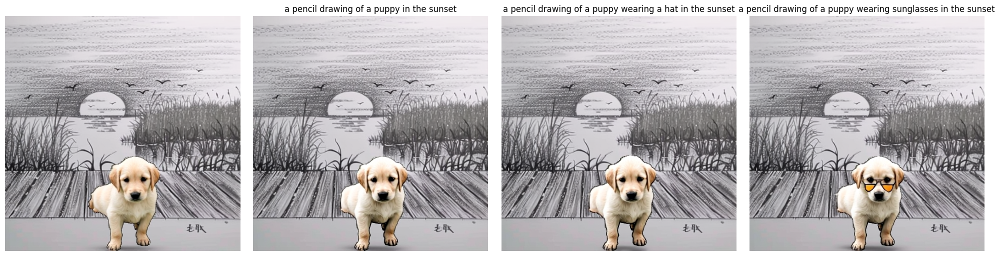

Example 2: Real-Sketch - a pencil drawing of a panda in the sunset
Running with prompt: 
Running inject qkv
Running with prompt: a pencil drawing of a panda in the sunset
Running inject qkv
Running with prompt: a pencil drawing of a panda wearing a hat in the sunset
Running inject qkv
Running with prompt: a pencil drawing of a panda wearing sunglasses in the sunset
Running inject qkv


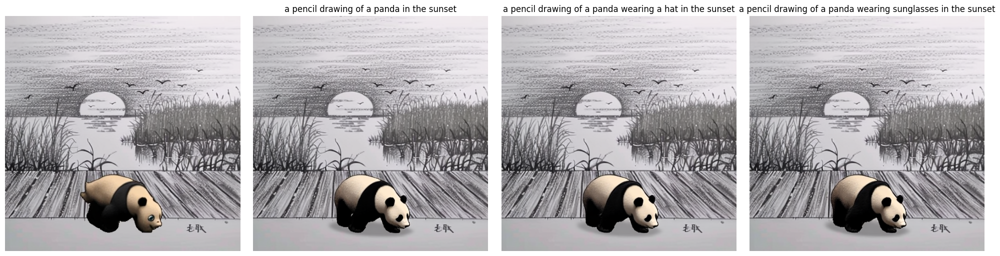

Category: painting
Example 1: Real-Painting - an oil painting of a waffle, Van Gogh Style
Running with prompt: 
Running inject qkv
Running with prompt: an oil painting of a waffle, Van Gogh Style
Running inject qkv
Running with prompt: an oil painting of a waffle with blueberries on top, Van Gogh Style
Running inject qkv
Running with prompt: an oil painting of a squirrel with a hat, Van Gogh Style
Running inject qkv


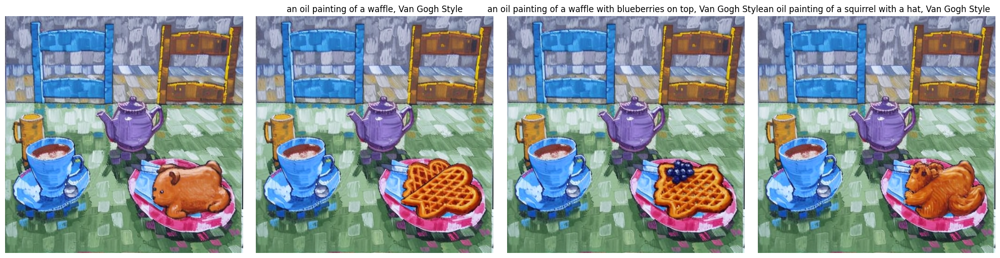

Example 2: Real-Painting -  an oil painting of a squirrel, Van Gogh Style
Running with prompt: 
Running inject qkv
Running with prompt:  an oil painting of a squirrel, Van Gogh Style
Running inject qkv
Running with prompt: a professional photograph of a BLUE mailbox on the grass, ultra realistic
Running inject qkv
Running with prompt: a professional photograph of a red lamppost on the grass, ultra realistic
Running inject qkv


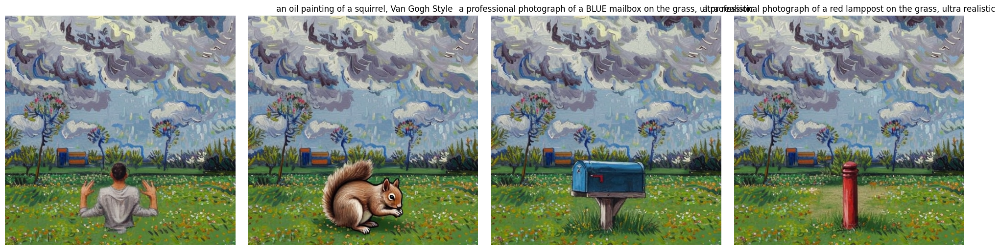

Category: cartoon
Example 1: Real-Cartoon - a cartoon animation of a castle and buildings
Running with prompt: 
Running inject qkv
Running with prompt: a cartoon animation of a castle and buildings
Running inject qkv
Running with prompt: a pencil drawing of a puppy wearing a hat in the sunset
Running inject qkv
Running with prompt: a pencil drawing of a puppy wearing sunglasses in the sunset
Running inject qkv


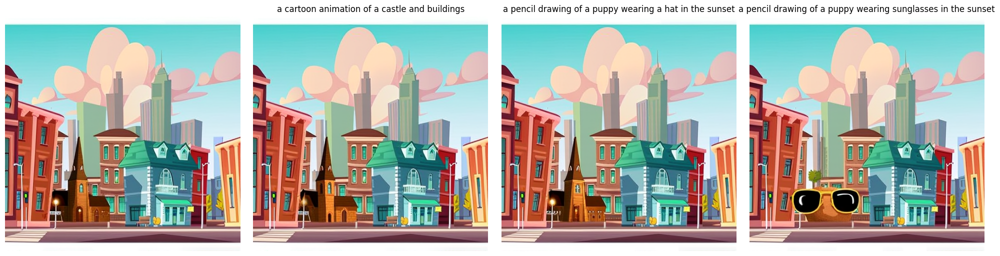

Example 2: Real-Cartoon - a cartoon animation of a sheep in the forest
Running with prompt: 
Running inject qkv
Running with prompt: a cartoon animation of a sheep in the forest
Running inject qkv
Running with prompt: a cartoon animation of a fortress and buildings
Running inject qkv
Running with prompt: a cartoon animation of a sheep in the forest, wearing a party hat
Running inject qkv


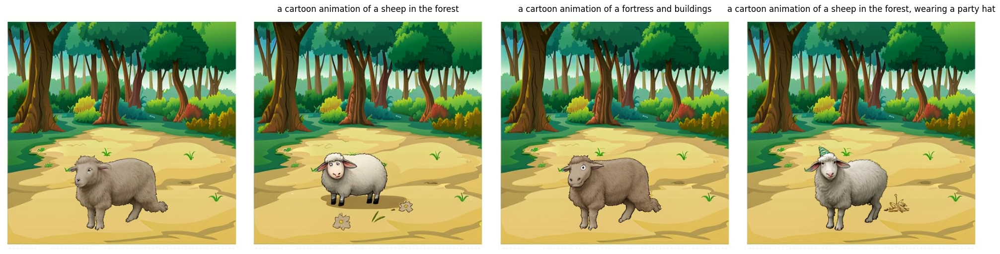

In [ ]:
for category, examples in EXAMPLES_DICT.items():
    print(f"Category: {category}")
    for i, example in enumerate(examples):

        print(f"Example {i+1}: {example.category} - {example.prompt}")
        all_test_prompts = PROMPTS_DICT.get(example)

        images_to_plot = list()
        titles_to_plot = list()
        
        for prompt in all_test_prompts:
            print(f"Running with prompt: {prompt}")


            # Run the editing example
            result_image = run_editing_example(cached_pipe, example, prompt, CONFIG)
            images_to_plot.append(result_image)
            titles_to_plot.append(prompt)
            
            # # Display the original and edited images side by side
            # display_side_by_side(example.fg_image, example.bg_image, result_image, titles=["Foreground", "Background", "Edited Result"])
            
        
        # Get scores for the edited image
        fig, axes = plt.subplots(1, len(images_to_plot), figsize=(5 * len(images_to_plot), 5))
        for i, image in enumerate(images_to_plot):
            axes[i].imshow(image)
            axes[i].set_title(titles_to_plot[i])
            axes[i].axis('off')
        plt.tight_layout()
        plt.show()